# CIS6800: Project 3: SOLO and FPN (Instance Segmentation)
### Due:
* Part (a) Oct. 18 at 11:59 p.m.
* Part (b) Oct. 23 at 11:59 p.m.

### Instructions:
* This is a group assignment with one submission per group. It is expected that each member of the group will contribute to solving each question. Be sure to specify your teammates when you submit to Gradescope! Collaborating with other groups is not permitted.
* There is no single answer to most problems in deep learning, therefore the questions will often be underspecified. You need to fill in the blanks and submit a solution that solves the (practical) problem. Document the choices (hyperparameters, features, neural network architectures, etc.) you made where specified.
* All the code should be written in Python.
* You may include any code used in previous projects.
* You should expect that a complete training session should last about 6 hours, so you should start part (b) as early as you can!
* To save on compute time, we debugging locally and using colab to train.

## Code Structure
In this assignment, we are only providing the barest templates for your code structure. If you prefer, you can write and debug most of the components in a regular python and only use Jupyter to train. In this case, you might have several files that you import into this notebook, e.g.
* `dataset.py`
* `model.py`
* `train.py`
* `inference.py`

This is shown below. All files should be included in your submission.

In [ ]:
try:
    import dataset
    import model
    import train
    import inference
except ModuleNotFoundError:
    pass

## Overview

Instance segmentation can be thought of as a combination of object detection and semantic segmentation, the former of which you already explored in the previous project. A visulization of this relationship can be seen in fig. 1.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig1.png" width=500/></div>
<center>Figure 1: An overview of instance segmentation.</center>  

In this project, you are tasked with implementing an instance segmentation framework know as SOLO (Segmenting Object by LOcations). In a similar manner to YOLO, SOLO produces mask predictions on a dense grid. This means that, unlike many other segmenation frameworks (e.g. Mask-RCNN), SOLO directly predicts the segmentation mask without proposing bounding box locations. An visual summary of SOLO can be seen in fig. 2 and 3.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig2.png" width=200/></div>
<center>Figure 2: SOLO.</center>  

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig3.png" width=600/></div>
<center>Figure 3: SOLO branches.</center>

These dense predictions are produced at several different scales using a Feature Pyramid Network (FPN). Using the last few layers of the backbone, we pass the higher level features from the deeper layers back up to larger features scales using lateral connections, shown in fig. 4. The integration of the FPN into your network will be the primary focus of this project.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig4.png" width=300/></div>
<center>Figure 4: SOLO branches.</center>

## Part A

### Dataset
#### Dataset Structure
The dataset used in this project contains three classes across 3265 images: vehicles, people, and animals. The dataset contains the following elements:

* A numpy array of images ($3 \times 300 \times 400$).
* A numpy array of masks ($300 \times 400$).
* A list of ground truth labels by image.
* A list of bounding boxes by image.

Note that the mask array is flattened; to determine which masks belong to which image, count the number of labels associated with that image. For example, if the first few images have 3, 2, and 4 labels, masks 0-2 would belong to image 1, masks 3-4 would belong to image 2, etc. The masks are ordered correctly to allow for this. You can find the dataset set here: https://drive.google.com/drive/folders/1eP7FtPaWfJ5zLdcsZYl6eyn5EYixkFn8

#### Loading and Batching
You should apply the following transformations to each image:
* Normalize pixel values to $[0,1]$.
* Rescale the image to $800 \times 1066$.
* Normalize each channel with means $[0.485, 0.456, 0.406]$ and standard deviations $[0.229, 0.224, 0.225]$.
* Zero pad the image to $800 \times 1088$.

Since each image will have a different number of objects, you will have to write your own collation function to properly batch the images. An example collate_fn is shown below, along with expected output dimensions.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from __future__ import print_function, division
!pip install pytorch_lightning &> /dev/null


from torchvision.utils import draw_bounding_boxes
import os
import copy
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader, random_split, TensorDataset
from torchvision import transforms, utils
from  matplotlib.patches import Rectangle as rec
import numpy as np
import h5py
import cv2
import matplotlib.pyplot as plt
import torch
import torchvision
import torchvision.transforms as transforms
from PIL import Image
from scipy import ndimage
import torch.nn.functional as F

import torch.nn as nn
import pytorch_lightning as pl
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

# CUDA for PyTorch
use_cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if use_cuda else "cpu")
seed = 17
torch.manual_seed(seed);

##FINAL

In [ ]:
# import numpy as np
# import h5py

# image_path  = '/content/drive/MyDrive/CIS 680/hw3_mycocodata_img_comp_zlib.h5'
# label_path  = '/content/drive/MyDrive/CIS 680/hw3_mycocodata_labels_comp_zlib.npy'
# bbox_path   = '/content/drive/MyDrive/CIS 680/hw3_mycocodata_bboxes_comp_zlib.npy'
# mask_path   = '/content/drive/MyDrive/CIS 680/hw3_mycocodata_mask_comp_zlib.h5'

# path = [image_path, label_path, bbox_path, mask_path]

# def load_data(file_name):
#     return np.load(file_name, allow_pickle=True, encoding='latin1')

# with h5py.File(path[0], 'r') as f:
#   images = f['data'][()]

# with h5py.File(path[3], 'r') as f:
#   masks = f['data'][()]

# labels         = load_data(path[1])
# bounding_boxes = load_data(path[2])    

In [100]:
class MyDataset(Dataset):
    def __init__(self, path, transform_images = None, transform_masks = None):

        h5_file_imgs  = h5py.File(path[0],'r')
        self.images   = h5_file_imgs[list(h5_file_imgs.keys())[0]]
        self.images   = np.transpose(self.images,(0,2,3,1)).astype(np.uint8)
        self.bboxes   = self.load_data(path[2])
        self.labels   = self.load_data(path[1])

        h5_file_mask  = h5py.File(path[3],'r')
        self.masks    = h5_file_mask[list(h5_file_mask.keys())[0]]
        
        self.masks_stacked    = []
        self.preprocess()
        self.transform_images = transform_images
        self.transform_masks  = transform_masks

    def __len__(self):
        return len(self.images)
    
    def load_data(self, file_name):
        return np.load(file_name, allow_pickle=True, encoding='latin1')

    def preprocess(self):
        j = 0
        for i in range(len(self.labels)):
            self.masks_stacked.append(self.masks[j:j+len(self.labels[i])])
            j = j + len(self.labels[i])
            
    
    def preprocess_boxes(self,bboxes_1):
        # print(bboxes[0].shape)
        for i in range(len(bboxes_1)):
            bboxes_1[i][0] = bboxes_1[i][0] * (800/300)
            bboxes_1[i][2] = bboxes_1[i][2] * (800/300) 
            bboxes_1[i][1] = (bboxes_1[i][1] * (1066/400)) + 11
            bboxes_1[i][3] = (bboxes_1[i][3] * (1066/400)) + 11
        return bboxes_1

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx   = idx.tolist()

        images = copy.deepcopy(self.images[idx])
        labels = copy.deepcopy(self.labels[idx])
        masks  = copy.deepcopy(self.masks_stacked[idx]).astype(np.uint8)
        masks  = np.transpose(masks, (1,2,0))
        # print('mm',masks.shape)

        bboxes_1 = copy.deepcopy(self.bboxes[idx])
        bboxes = self.preprocess_boxes(bboxes_1)

        if self.transform_images:
            images = self.transform_images(images)
        if self.transform_masks:
            masks  = self.transform_masks(masks)

        data    = [images, labels, masks, bboxes]
        return data

In [106]:
image_path  = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_img_comp_zlib.h5'
label_path  = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_labels_comp_zlib.npy'
bbox_path   = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_bboxes_comp_zlib.npy'
mask_path   = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_mask_comp_zlib.h5'

path = [image_path, label_path, bbox_path, mask_path]

dataset = MyDataset(
        path,
        transform_images = transforms.Compose([transforms.ToTensor(), transforms.Resize((800,1066)), transforms.Normalize((0.485,0.456,0.406), (0.229,0.224,0.225)),  transforms.Pad((11,0))]),
        transform_masks  = transforms.Compose([transforms.ToTensor(), transforms.Resize((800,1066)), transforms.Pad((11,0))])
        )

In [101]:
# images:         (batch_size, 3, 800, 1088)
# labels:         list with len: batch_size, each (n_obj,)
# masks:          list with len: batch_size, each (n_obj, 800,1088)
# bounding_boxes: list with len: batch_size, each (n_obj, 4)
def collate_fn(batch):
    images, labels, masks, bounding_boxes = list(zip(*batch))
    return torch.stack(images), labels, masks, bounding_boxes

In [102]:
def visualize(data):
    true_img, labels, mask, bboxes = data

    fig     = plt.figure()
    ax      = fig.add_subplot()
    true_img = np.transpose(true_img,(1,2,0))
    ax.imshow(true_img)

    for i in range(len(labels)):
        #####
        new_img  = np.reshape(mask[i, :, :], (mask.shape[1], mask.shape[2]))
        new_img  = np.stack( (new_img, new_img, new_img), axis=2)
        
        red, green, blue = np.zeros_like(new_img), np.zeros_like(new_img), np.zeros_like (new_img)
        blue[:]   = (0, 0, 255)
        green[:]  = (0, 255, 0)
        red[:]    = (255, 0, 0)
        mask_cmap = {1: red, 2: green, 3: blue}
        new_img   = np.where(new_img > 0, mask_cmap[labels[i]], true_img)
        ax.imshow(new_img, alpha=0.7)
        
        #####
        if labels[i] == 0 : #None
            c = 'purple'
            plt.title('Visualising image: {} after pre-processing with mask: {} (None)'.format(i, 0))
        if labels[i] == 1 : #Objects
            c = 'red'
            plt.title('Visualising image: {} after pre-processing with mask: {} (Objects)'.format(i, 1))
        if labels[i] == 2 : #animals 
            c = 'green'
            plt.title('Visualising image: {} after pre-processing with mask: {} (Humans)'.format(i, 2))
        if labels[i] == 3 : # OThers
            c = 'blue'
            plt.title('Visualising image: {} after pre-processing with mask: {} (Animals/Birds)'.format(i, 3))

        ax.add_patch(rec((bboxes[i][2], bboxes[i][3],), bboxes[i][0] - bboxes[i][2], bboxes[i][1] - bboxes[i][3] , edgecolor = c, facecolor='none'))

In [111]:
def visualise_targets(true_img, labels, mask_tar, category_tar, active_tar):

    for idx1, each_img in enumerate(category_tar):
        for idx2, each_level in enumerate(each_img):
            fig         = plt.figure()
            ax          = fig.add_subplot()
            new_img     = np.transpose(true_img[idx1],(1,2,0))

            index            = np.where(active_tar[idx1][idx2] == 1)[0]
            active_msk       = mask_tar[idx1][idx2][index]

            active_msk_depth = torch.sum(active_msk, dim = 0)
            active_msk_plt   = F.interpolate(active_msk_depth.unsqueeze(0).unsqueeze(0), size=(800,1088), mode='nearest').squeeze(0).squeeze(0)
            
            active_msk_plt   = np.repeat(active_msk_plt[:, :, np.newaxis], 3, axis=2)

            red, green, blue = np.zeros_like(active_msk_plt), np.zeros_like(active_msk_plt), np.zeros_like (active_msk_plt)
            blue[:]   = (0, 0, 255)
            green[:]  = (0, 255, 0)
            red[:]    = (255, 0, 0)
            mask_cmap = {1: red, 2: green, 3: blue}
            
            if category_tar[idx1][idx2].max().item() != 0:
                m = np.where(active_msk_plt, mask_cmap[category_tar[idx1][idx2].max().item()], new_img)
                ax.imshow(m)
                plt.title('Pyramid Level: {} for image:{} with Mask: {}'.format(idx2, idx1, category_tar[idx1][idx2].max().item()))
            else:
                ax.imshow(new_img)
                plt.title('Pyramid Level: {} for image:{} with no Mask'.format(idx2, idx1))
    

## Text

#### Visualization
In order to validate that you are loading the dataset correct, you should plot at least five example images that include the mask, annotations, and bounding boxes. Examples of such images are shown in fig. 5 and 6. Make sure that the color for each class is consistent!

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig5.png" width=500/></div>
<center>Figure 5: Example visualization.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig6.png" width=500/></div>
<center>Figure 6: Example visualization.</center>

### Model
#### Architecture
The model architecture is summarized in fig. 7 and tables 1 and 2.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig7.png" width=500/></div>
<center>Figure 7: SOLO branch structure.</center>
<br>
<center>Table 1: Category branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 3\times3\times(C-1)$, stride $= 1$, pad $= 1$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note $C = 4$ here (number of classes + background). |

<br>
<center>Table 2: Mask branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times(256 + 2)$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Two additional input channels represent the $x$ and $y$ positional encoding. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 1\times1\times(\text{num_grid})^2$, stride $= 1$, pad $= 0$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note that $\text{num_grid}$ is different for each layer of the FPN. |

We will be using a pretrained backbone (which includes an FPN), so you will not have to implement those components. A template for the network with along with default parameters is shown below.

#### Feature Pyramid
The feature pyramid extracted below has strides $[4,8,16,32,64]$ over the original image. To match the SOLO paper, this should be interpolated to have strides $[8,8,16,32,32]$.

#### Target Assignment
Some notes about generating the ground truth targets:
* The FPN levels can be though of as different grid sizes cut through the image.
* You assign each target to a certain FPN level if $\sqrt{wh}$ from the bounding box falls within the `scale_range` associated with that level. Note that these overlap, so you may assign the same target to multiple levels.
* A grid cell should be considered as predicting an object if that grid cell falls into the "centre region" of the object.
 * The centre region of an object is its bounding box scaled by `epsilon`.
 * Each grid cell can predict at most one object, but each object can be predicted by more than one grid cell.
 
#### Target Visualization
You should produce visualizations such as fig. 8 and 9 to validate your target assignments.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig8.png" width=500/></div>
<center>Figure 8: Target assignment example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig9.png" width=500/></div>
<center>Figure 9: Target assignment example.</center>

## Code

### Solo Class

In [117]:
import pytorch_lightning as pl

class SOLO(pl.LightningModule):
    _default_cfg = {
        'num_classes'   : 4,
        'in_channels'   : 256,
        'seg_feat_channels': 256,
        'stacked_convs' : 7,
        'strides'       : [8, 8, 16, 32, 32],
        'scale_ranges': [(1, 96), (48, 192), (96, 384), (192, 768), (384, 2048)],
        'epsilon'       : 0.2,
        'num_grids'     : [40, 36, 24, 16, 12],
        'mask_loss_cfg' : dict(weight=3),
        # 'cate_loss_cfg' : dict(gamma=2, alpha=0.25, weight=1),
        # 'postprocess_cfg': dict(cate_thresh=0.2, mask_thresh=0.5, pre_NMS_num=50, keep_instance=5, IoU_thresh=0.5)
        'cate_loss_cfg' : dict(gamma=2, alpha=0.25, weight=1),
        'postprocess_cfg': dict(cate_thresh=0.2, mask_thresh=0.4, pre_NMS_num=50, keep_instance=5, IoU_thresh=0.5)
    }
    
    def __init__(self, **kwargs):
        super().__init__()
        for k, v in {**self._default_cfg, **kwargs}.items():
            setattr(self, k, v)
        
        pretrained_model    = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=False, pretrained_backbone=True)
        self.backbone       = pretrained_model.backbone
            
        self.category_network = nn.Sequential(
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['num_classes'] - 1, kernel_size= 3, stride = 1, padding = 1, bias = True),
            nn.Sigmoid()
            )
       
        self.mask_network = nn.Sequential(
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] + 2, out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32, num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'], out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            nn.Conv2d(in_channels = self._default_cfg['in_channels'] , out_channels = self._default_cfg['seg_feat_channels'] , kernel_size= 3, stride = 1, padding = 1, bias = False),
            nn.GroupNorm(num_groups = 32 , num_channels = self._default_cfg['seg_feat_channels']),nn.ReLU(),
            )

        self.conv_out1 = nn.Conv2d(in_channels=self._default_cfg['in_channels'], out_channels=self._default_cfg['num_grids'][0]**2, kernel_size=1, stride=1, padding=0, bias=True)
        self.sig1 = nn.Sigmoid()
        self.conv_out2 = nn.Conv2d(in_channels=self._default_cfg['in_channels'], out_channels=self._default_cfg['num_grids'][1]**2, kernel_size=1, stride=1, padding=0, bias=True)
        self.sig2 = nn.Sigmoid()
        self.conv_out3 = nn.Conv2d(in_channels=self._default_cfg['in_channels'], out_channels=self._default_cfg['num_grids'][2]**2, kernel_size=1, stride=1, padding=0, bias=True)
        self.sig3 = nn.Sigmoid()
        self.conv_out4 = nn.Conv2d(in_channels=self._default_cfg['in_channels'], out_channels=self._default_cfg['num_grids'][3]**2, kernel_size=1, stride=1, padding=0, bias=True)
        self.sig4 = nn.Sigmoid()
        self.conv_out5 = nn.Conv2d(in_channels=self._default_cfg['in_channels'], out_channels=self._default_cfg['num_grids'][4]**2, kernel_size=1, stride=1, padding=0, bias=True)
        self.sig5 = nn.Sigmoid()


        self.num_grids      = self._default_cfg["num_grids"]
        self.strides        = self._default_cfg["strides"]
        self.epsilon        = self._default_cfg["epsilon"]
        self.num_of_classes = self._default_cfg['num_classes']
        self.pyramid_levels = len(self._default_cfg["num_grids"])
        self.alpha          = self._default_cfg['cate_loss_cfg']['alpha']
        self.gamma          = self._default_cfg['cate_loss_cfg']['gamma']
        self.lambda_cat     = self._default_cfg['cate_loss_cfg']['weight']
        self.mask_cat       = self._default_cfg['mask_loss_cfg']['weight']
        
        #Other intialization
        self.train_losses   = []
        self.val_losses     = []


    def category_branch_forward(self, x):
        out = self.category_network(x)
        return out

    def mask_branch_forward(self, x, i):
        x = self.mask_network(x)
        if i == 0 :
          x = self.sig1(self.conv_out1(x))
        elif i == 1 :
          x = self.sig2(self.conv_out2(x))
        elif i == 2 :
          x = self.sig3(self.conv_out3(x))
        elif i == 3 : 
          x = self.sig4(self.conv_out4(x))
        elif i == 4:
          x = self.sig5(self.conv_out5(x))
        return x

    def forward(self, images):
        '''
        Forward function should calculate across each level of the feature pyramid network.
        Input:
            images: batch_size number of images
        Output:
            if eval = False
                category_predictions: list, len(fpn_levels), each (batch_size, C-1, S, S)
                mask_predictions:     list, len(fpn_levels), each (batch_size, S^2, 2*feature_h, 2*feature_w)
            if eval==True
                category_predictions: list, len(fpn_levels), each (batch_size, S, S, C-1)
                / after point_NMS
                mask_predictions:     list, len(fpn_levels), each (batch_size, S^2, image_h/4, image_w/4)
                / after upsampling
        '''
        feature_pyramid         = [v.detach() for v in self.backbone(images).values()]
        category_predictions    = [[] for x in range(len(feature_pyramid))]
        mask_predictions        = [[] for x in range(len(feature_pyramid))]
        images.to(device)
        
        for level in range(len(feature_pyramid)):
          for i, each_image in enumerate(images):
    
            category_input = F.interpolate(feature_pyramid[level][i].unsqueeze(0), size=(self.num_grids[level], self.num_grids[level]), mode='bilinear')
            category_output = self.category_branch_forward(category_input)
            
            # Taking input as is for pyramid layers other than 1st and last
            mask_input = feature_pyramid[level][i]

            # First layer after FPN or last layer
            if level == 0 or level == (len(feature_pyramid) - 1):
              mask_input = F.interpolate(feature_pyramid[level][i].unsqueeze(0), size=(2*int(800 / self.strides[level]), 2* int(1088 / self.strides[level])), mode='bilinear')
            else:
              mask_input = torch.unsqueeze(mask_input, 0)
            
            # Creating a meshgrid to add two additional channels
            xx, yy = torch.meshgrid(torch.arange(mask_input.shape[3]), torch.arange(mask_input.shape[2]))
            xx = torch.transpose(xx, 1, 0).unsqueeze(0)
            yy = torch.transpose(yy, 1, 0).unsqueeze(0)
            
            # Normalise xx, yy to [-1, 1] as mentioned in the slides
            norm_ = torchvision.transforms.Normalize((0.5), (0.5))
            xx_norm = norm_(xx.to(torch.float64))
            yy_norm = norm_(yy.to(torch.float64))
            xx_norm = xx_norm.to(torch.int64).to(device)
            yy_norm = yy_norm.to(torch.int64).to(device)

            # Adding two channels to mask input after normalising
            mask_input = torch.cat((torch.squeeze(mask_input, 0), xx_norm,  yy_norm), dim=0).to(device)
            mask_input = torch.unsqueeze(mask_input, 0)
            mask_output = self.mask_branch_forward(mask_input, level)
            mask_output = F.interpolate(mask_output, size=( int(2*800/self.strides[level]), int(2* 1088 / self.strides[level])), mode='bilinear').squeeze(0)

            category_predictions[level].append(category_output)
            mask_predictions[level].append(mask_output)

        return category_predictions, mask_predictions
    
    def generate_targets(self, bounding_boxes, labels, masks):
        '''
        This function build the ground truth tensor for each batch in the training
        Input:
            bounding_boxes:   list, len(batch_size), each (n_object, 4) (x1 y1 x2 y2 system)
            labels:           list, len(batch_size), each (n_object, )
            masks:            list, len(batch_size), each (n_object, 800, 1088)
        Output:
            category_targets: list, len(batch_size), list, len(fpn), (S, S), values are {1, 2, 3}
            mask_targets:     list, len(batch_size), list, len(fpn), (S^2, 2*feature_h, 2*feature_w)
            active_masks:     list, len(batch_size), list, len(fpn), (S^2,)
            / boolean array with positive mask predictions
        '''
        category_targets  = [[] for x in range(len(bounding_boxes))]
        mask_targets      = [[] for x in range(len(bounding_boxes))]
        active_masks      = [[] for x in range(len(bounding_boxes))]
        active_levels     = [[] for x in range(len(bounding_boxes))]

        for idx, each_image in enumerate(bounding_boxes):

            x1 = each_image[:, 0].reshape(-1, 1)
            y1 = each_image[:, 1].reshape(-1, 1)
            x2 = each_image[:, 2].reshape(-1, 1)
            y2 = each_image[:, 3].reshape(-1, 1)
            
            mask_height, mask_width = masks[idx][0].shape
            
            width     = x2 - x1
            height    = y2 - y1
            big_area  = width * height
            root_wh   = torch.sqrt(torch.from_numpy(big_area))

            level_list = [torch.logical_and(root_wh >= 1, root_wh <= 96), torch.logical_and(48 <=root_wh, root_wh<=192), torch.logical_and(96<=root_wh, root_wh<=384), 
                        torch.logical_and(192<=root_wh, root_wh <=768), torch.logical_and(384<=root_wh, root_wh<=2048)]

            boxes_level = []
            
            for i in range(len(root_wh)):
                a   = torch.tensor([root_wh[i] < 96, torch.logical_and(48 <root_wh[i], root_wh[i]<192), torch.logical_and(96<root_wh[i], root_wh[i]<384), 
                                    torch.logical_and(192<root_wh[i], root_wh[i]<768), torch.logical_and(384<=root_wh[i], root_wh[i] <2048)])
                a = torch.where(a)[0]
                boxes_level.append(a)

            for level_idx in range(self.pyramid_levels):
                level_category_mask_tensor  = torch.zeros((self.num_grids[level_idx], self.num_grids[level_idx]))
                level_mask_targets_tensor   = torch.zeros((self.num_grids[level_idx]**2, (2* 800)//self.strides[level_idx], (2*1088) // self.strides[level_idx]))
                level_active_masks          = torch.zeros((self.num_grids[level_idx]*self.num_grids[level_idx]))

                # For mask_targets
                H_2 = int(2 * mask_height/self.strides[level_idx])
                W_2 = int(2 * mask_width /self.strides[level_idx])

                level_masks = F.interpolate(masks[idx].unsqueeze(0), size=(H_2,W_2), mode='nearest').squeeze(0).detach().cpu()
                
                for box_idx, each_box in enumerate(each_image):
                    # Calculating x1, y1, x2, y2 for each level
                    x1_level_box = each_box[0]
                    y1_level_box = each_box[1]
                    x2_level_box = each_box[2]
                    y2_level_box = each_box[3]

                    # Box width and Box Height
                    big_width = each_box[2] - each_box[0]
                    big_height = each_box[3] - each_box[1]

                    # X Center, y_center for small box based on SXS array
                    x_center_level = ((x1_level_box + x2_level_box) / 2)
                    y_center_level = ((y1_level_box + y2_level_box) / 2)
                
                    # Scaled width, scaled height for SXS matrix
                    scaled_width  = self.epsilon * (big_width) 
                    scaled_height = self.epsilon * (big_height)

                    x1_level_box_small = int((x_center_level - (scaled_width/2))   * (self.num_grids[level_idx] / 1088))
                    y1_level_box_small = int((y_center_level - (scaled_height/2))  * (self.num_grids[level_idx]/800))
                    
                    x2_level_box_small = int((x_center_level + (scaled_width/2))   * (self.num_grids[level_idx] / 1088))
                    y2_level_box_small = int((y_center_level + (scaled_height/2))  * (self.num_grids[level_idx]/800))

                    if torch.isin(boxes_level[box_idx], level_idx).any(axis=0):
                        
                        xx, yy = torch.meshgrid(torch.arange(y1_level_box_small, y2_level_box_small+1), torch.arange(x1_level_box_small, x2_level_box_small+1))
                      
                        level_category_mask_tensor[xx, yy] = labels[idx][box_idx]
                        level_mask_targets_tensor[xx.flatten()*self.num_grids[level_idx] + yy.flatten()] = level_masks[box_idx]
                        level_active_masks[xx.flatten()*self.num_grids[level_idx] + yy.flatten()] = 1
                        active_levels_2 = True

                    else:
                        active_levels_2 = False

                mask_targets[idx].append(level_mask_targets_tensor)
                category_targets[idx].append(level_category_mask_tensor)
                active_masks[idx].append(level_active_masks) 

        return mask_targets, category_targets, active_masks


    def sorting(self, category_predictions, mask_predictions):
      image_h_4         = int(800 /4)
      image_w_4         = int(1088/4)
      categories_sorted = []
      level_list        = []
      scores_list       = []
      indices_list      = []
      class_list        = []

      for i in range(5):
        class_max, indicies_cls   = torch.max(category_predictions[i][0].reshape(category_predictions[i][0].shape[0], category_predictions[i][0].shape[2]**2), dim=0)
        cate_idx                  = torch.where(class_max  > self.postprocess_cfg["cate_thresh"])[0]

        above_thresh_classes      = indicies_cls[cate_idx]

        mask_predictions[i][0]    = F.interpolate(mask_predictions[i][0].unsqueeze(0), size=(image_h_4, image_w_4), mode='bilinear').squeeze(0)
        mask_thresh               = mask_predictions[i][0] > self.postprocess_cfg["mask_thresh"]

        category_score_num        = torch.sum(mask_predictions[i][0] * mask_thresh, dim=(1, 2))
        category_score_denom      = torch.sum(mask_thresh, dim=(1, 2))

        category_score            = class_max * category_score_num/category_score_denom
        
        category_score            = torch.where(torch.isnan(category_score), 0, category_score)
        category_score            = category_score[cate_idx]

        level_list.append(torch.ones(len(cate_idx))*i)
        scores_list.append(category_score)
        indices_list.append(cate_idx)
        class_list.append(above_thresh_classes)


      scores        = torch.hstack(scores_list)
      levels        = torch.hstack(level_list)
      indices       = torch.hstack(indices_list)
      labels_levels = torch.hstack(class_list) 

      indices_sorted  = torch.argsort(scores, descending=True)
      sorted_scores   = scores[indices_sorted]
      sorted_levels   = levels[indices_sorted]
      sorted_indices  = indices[indices_sorted]
      sorted_classes  = labels_levels[indices_sorted]

      sorted_masks    = torch.zeros((len(indices_sorted), image_h_4, image_w_4), device=device)

      for ind in range(len(sorted_indices)):
        
        level_1_sorted = sorted_levels[ind].to(torch.int32)
        i             = sorted_indices[ind]
        cat_pred      = category_predictions[level_1_sorted][0].reshape(self.num_classes-1, -1)
        cat_pred      = torch.argmax(cat_pred[:,i])
        categories_sorted.append(cat_pred.item())

        mask_1                  = mask_predictions[level_1_sorted][0][i].unsqueeze(0)
        sorted_masks[ind,:,:]   = mask_1

      
      categories_sorted       = torch.tensor(categories_sorted)

      del scores, levels, indices, labels_levels, sorted_levels, sorted_indices, level_1_sorted, i,  cat_pred, mask_1, level_list, scores_list, indices_list, class_list       
      return sorted_scores, sorted_masks, categories_sorted, sorted_classes

    # Credit to SOLO Author's code
    def points_nms(self, heat, kernel=2):
        '''
        This function does NMS on the heat map (category_prediction), grid-level
        Input:
            heat: (batch_size, C-1, S, S)
        Output:
            (batch_size, C-1, S, S)
            kernel must be 2
        '''
        hmax = F.max_pool2d(
            heat, (kernel, kernel), stride=1, padding=1)
        keep = (hmax[:, :, :-1, :-1] == heat).float()
        return heat * keep


    def MatrixNMS(self, sorted_masks, sorted_scores, method='gauss', gauss_sigma=0.5):
        '''
        This function performs Matrix NMS
        Input:
            sorted_masks: (n_active, image_h/4, image_w/4)
            sorted_scores: (n_active,)
        Output:
            decay_scores: (n_active,)
        '''
        n = len(sorted_scores)
        sorted_masks = sorted_masks.reshape(n, -1)
        intersection = torch.mm(sorted_masks, sorted_masks.T)
        areas = sorted_masks.sum(dim=1).expand(n, n)
        union = areas + areas.T - intersection
        ious = (intersection / union).triu(diagonal=1)

        ious_cmax = ious.max(0)[0].expand(n, n).T
        if method == 'gauss':
            decay = torch.exp(-(ious ** 2 - ious_cmax ** 2) / gauss_sigma)
        else:
            decay = (1 - ious) / (1 - ious_cmax)
        decay = decay.min(dim=0)[0]
        return sorted_scores * decay


    def post_process(self, image, imagenum):
        images = image.unsqueeze(0).to(device)
        category_predictions, mask_predictions = self.forward(images)

        category_predictions_pp = []

        for pyr in range(len(category_predictions)):
          category_predictions_pp.append(self.points_nms(category_predictions[pyr][0])) #.permute(0,2,3,1)


        scores, masks, categories, new_classes = self.sorting(category_predictions_pp, mask_predictions)        
        
        NMS_output        = self.MatrixNMS(masks, scores)
        final_idx         = torch.sort(NMS_output, descending=True)[1]
        best              = final_idx[:3]
        very_new_classes  = new_classes[best]

        mask = F.interpolate(masks.unsqueeze(0), size=(800, 1088), mode='bilinear').squeeze(0)
        mask = mask[best]
        # print(mask.max())
        mask = torch.where(mask > 0.3, 1, 0).detach().cpu().numpy()
        
        categories_new  = categories[best]
        mask_to_display = np.zeros((800, 1088, 3))

        for i in range(len(categories_new)):
          clss = categories[i]
          mask_to_display[:,:,clss] = mask[i,:,:]

        del mask, final_idx, NMS_output, scores, masks, categories, categories_new, category_predictions_pp, category_predictions, mask_predictions
        return mask_to_display

    def Mask_loss(self, mask_predictions, mask_targets, active_masks):
        '''
        I/P: mask_predictions : levels * batch * S**2 * C
             mask_targets     : batch  * levels* S**2 * C
             active_mask      : batch  * levels* S**2
        
        O/P: Mask_Loss 
        '''
        TN = 0
        inner_loss  = []
        inner_loss_2= []
        loss        = []
        #For evey image in the batch
        for each_img in range(len(mask_targets)):
            inner_loss      = []
            # For every layer
            for each_layer in range(len(self.num_grids)):

                N = torch.sum(active_masks[each_img][each_layer]!=0)
                TN += N
                if N.item()!=0:   
                    active = np.where(active_masks[each_img][each_layer]!= 0)[0]
                    m = mask_targets[each_img][each_layer][active,:,:].to(device)
                    m_star = mask_predictions[each_layer][each_img][active,:,:].to(device)
                    
                    DD     = (2 * torch.sum(m * m_star))\
                           / (torch.sum(torch.square(m)) + torch.sum(torch.square(m_star)) + 0.00001)
                    
                    l_mask       = 1 - DD
                    l_mask_level = l_mask
                    inner_loss.append(l_mask_level)               
                
            inner_loss_2.append(torch.sum(torch.stack(inner_loss)))

        final_loss = torch.sum(torch.stack(inner_loss_2))
        # return final_loss/len(mask_targets)
        return final_loss/TN
        # return final_loss
    

    def Category_Loss(self, category_predictions, category_ground_truths):
        '''
        I/P: category_predictions   : levels * batch * S**2 * C
             category_ground_truths : batch  * levels* S**2 * C

        O/P: Category_Loss 
        '''
        level_combo_1 = []
        level_combo_2 = []
        level_combo_3 = []
        level_combo_4 = []
        level_combo_5 = []

        for i, batch in enumerate(category_ground_truths):
            level_combo_1.append(batch[0])
            level_combo_2.append(batch[1])
            level_combo_3.append(batch[2])
            level_combo_4.append(batch[3])
            level_combo_5.append(batch[4])

        category_ground_truths_reshape = [level_combo_1, level_combo_2, level_combo_3, level_combo_4, level_combo_5]

        loss = []
        for each_layer in range(len(self.num_grids)):
            FL = []
            for each_img in range(len(category_ground_truths)):
                category_predictions_reshape = category_predictions[each_layer][each_img].permute(0,2,3,1)
                
                p               = torch.flatten(category_predictions_reshape).to(device)
                y               = torch.flatten(category_ground_truths_reshape[each_layer][each_img]).to(device)

                one_hot_y       = torch.nn.functional.one_hot(y.to(torch.int64), num_classes = 4)
                y_final         = one_hot_y[:,1:]
                y_final         = torch.flatten(y_final)

                alpha_lst       = torch.ones_like(y_final) * self.alpha
                idx             = torch.where(y_final == 1)[0]

                alpha_lst[idx]  = 1-self.alpha
                p[idx]          = 1-p[idx]
                 
                each_layer_sum  = torch.sum(((-1) * alpha_lst) * ((1 - p)**self.gamma) * torch.log(p + 0.00001)) / ((self.num_grids[each_layer]**2) * self.num_of_classes) 

                FL.append(each_layer_sum)
            loss.append(torch.mean(torch.stack(FL)))
        final_loss = torch.mean(torch.stack(loss))

        return final_loss    

    def loss_fn(self,category_predictions, category_ground_truths, mask_predictions, mask_ground_truths, active_masks):
        
        c_loss  = self.Category_Loss(category_predictions, category_ground_truths)
        m_loss  = self.Mask_loss(mask_predictions, mask_ground_truths, active_masks)
        loss    =  (self.lambda_cat * c_loss) + (self.mask_cat * m_loss)
        # print(m_loss)
        return loss, c_loss, m_loss

    def training_step(self, batch, batch_idx):
        images, labels, masks, bounding_boxes                       = batch
        mask_ground_truths, category_ground_truths, active_masks    = self.generate_targets(bounding_boxes, labels, masks)  
        category_predictions, mask_predictions                      = self.forward(images)

        loss, cat_loss, m_loss = self.loss_fn(category_predictions, category_ground_truths, mask_predictions, mask_ground_truths, active_masks)

        self.log("train_loss",          loss,       prog_bar=True)
        self.log("train_category_loss", cat_loss,   prog_bar=True)
        self.log("train_mask_loss",     m_loss,     prog_bar=True)

        # del images, labels, masks, bounding_boxes
        # del mask_ground_truths, category_ground_truths, active_masks
        # torch.cuda.empty_cache()

        return {"loss": loss, "category_loss": cat_loss, "mask_loss": m_loss}

    def training_epoch_end(self, outputs):
        train_loss        = torch.tensor([output["loss"]            for output in outputs]).mean().item()
        train_cat_loss    = torch.tensor([output["category_loss"]   for output in outputs]).mean().item()
        train_mask_loss   = torch.tensor([output["mask_loss"]       for output in outputs]).mean().item()

        self.train_losses.append((train_loss, train_cat_loss, train_mask_loss))

    def validation_step(self, batch, batch_idx):
        images, labels, masks, bounding_boxes                       = batch
        mask_ground_truths, category_ground_truths, active_masks    = self.generate_targets(bounding_boxes, labels, masks)
        category_predictions, mask_predictions                      = self.forward(images)

        loss, cat_loss, m_loss = self.loss_fn(category_predictions, category_ground_truths, mask_predictions, mask_ground_truths, active_masks)

        self.log("val_loss",            loss,       prog_bar=True)
        self.log("val_category_loss",   cat_loss,   prog_bar=True)
        self.log("val_mask_loss",       m_loss,     prog_bar=True)

        # del images, labels, masks, bounding_boxes
        # del mask_ground_truths, category_ground_truths, active_masks
        # torch.cuda.empty_cache()

        return {"loss": loss, "category_loss": cat_loss, "mask_loss": m_loss}
        
    def validation_epoch_end(self, outputs):
        val_loss        = torch.tensor([output["loss"]          for output in outputs]).mean().item()
        val_cat_loss    = torch.tensor([output["category_loss"] for output in outputs]).mean().item()
        val_mask_loss   = torch.tensor([output["mask_loss"]     for output in outputs]).mean().item()

        self.val_losses.append((val_loss, val_cat_loss, val_mask_loss))


    def configure_optimizers(self):
        opt     = torch.optim.SGD(self.parameters(), lr=0.01, weight_decay=1e-4, momentum=0.9)
        sched   = {"scheduler": torch.optim.lr_scheduler.MultiStepLR(opt, milestones=[26, 32], gamma=0.1)}

        return {"optimizer": opt, "lr_scheduler": sched}

In [107]:
from pytorch_lightning.callbacks import ModelCheckpoint
val_checkpoint_callback = ModelCheckpoint(
    monitor="val_loss",
    dirpath="./training_data_new_model_10",
    filename="val_loss{epoch:02d}-{val_loss:.2f}",
    save_top_k=3,
    mode="min",
)
train_checkpoint_callback = ModelCheckpoint(
    monitor="train_loss",
    dirpath="./training_data_new_model_10",
    filename="train_loss{epoch:02d}-{train_loss:.2f}",
    save_top_k=3,
    mode="min",
)

train_len = 0.8
eval_len  = 0.2

train_size  = int(train_len * len(dataset))
test_size   = int(eval_len  * len(dataset))

train_dataset = torch.utils.data.Subset(dataset, range(train_size))
test_dataset  = torch.utils.data.Subset(dataset, range(train_size, train_size + test_size))

trainloader = DataLoader(train_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)
testloader  = DataLoader(test_dataset,   batch_size=4, shuffle=False, collate_fn=collate_fn)

In [96]:
model = SOLO()
model.eval().to(device).load_state_dict(torch.load('solo_100.pth'))

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and will be removed in 0.15, please use 'weights_backbone' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight

<All keys matched successfully>

### Train test case

In [ ]:
model10 = SOLO()
tb_logger = pl_loggers.TensorBoardLogger("logs10/")
trainer = pl.Trainer(gpus=1,logger=tb_logger, max_epochs=45,callbacks=[val_checkpoint_callback,train_checkpoint_callback])
trainer.fit(model10,trainloader,testloader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:616: UserWarning: Checkpoint directory /content/training_data_new_model_10 exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
   | Name             | Type            | Params
------------------------------------------------------
0  | backbone         | BackboneWithFPN | 26.8 M
1  | category_network | Sequential      | 4.1 M 
2  | mask_network     | Sequential      | 4.1 M 
3  | conv_out1        | Conv2d

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=45` reached.


In [ ]:
model9 = SOLO()
tb_logger = pl_loggers.TensorBoardLogger("logs9/")
trainer = pl.Trainer(gpus=1,logger=tb_logger, max_epochs=36,callbacks=[val_checkpoint_callback,train_checkpoint_callback])
trainer.fit(model9,trainloader,testloader)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and will be removed in 0.15, please use 'weights_backbone' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight

  0%|          | 0.00/97.8M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is deprecated in v1.7 and will be removed"
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
   | Name             | Type            | Params
------------------------------------------------------
0  | backbone         | BackboneWithFPN | 26.8 M
1  | category_network | Sequential      

Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/data.py:99: UserWarning: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 4. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.
  "Trying to infer the `batch_size` from an ambiguous collection. The batch size we"
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1896: PossibleUserWarning: The number of training batches (25) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  category=PossibleUserWarning,


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=36` reached.


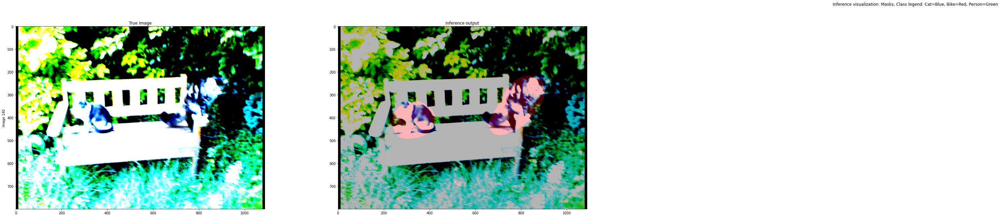

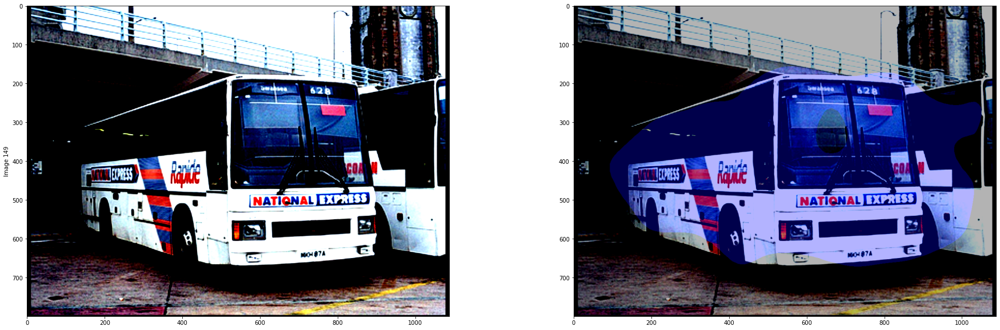

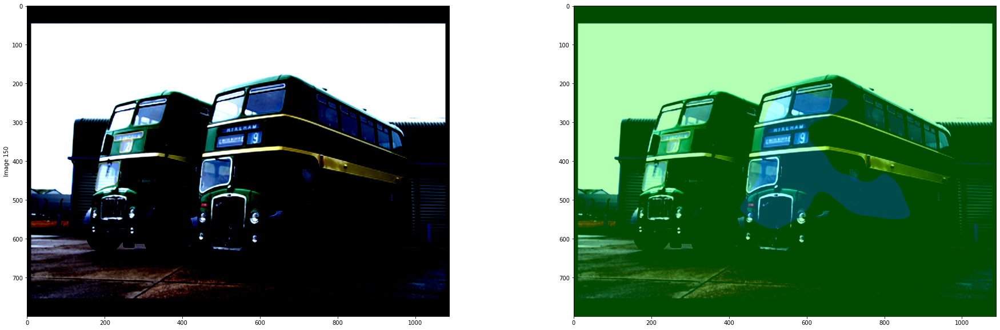

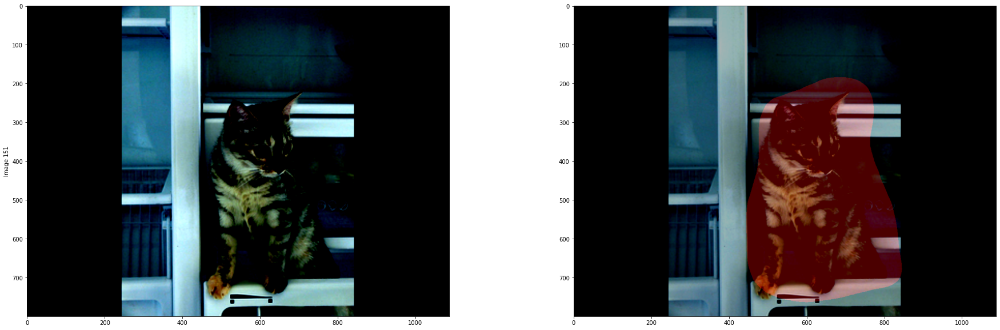

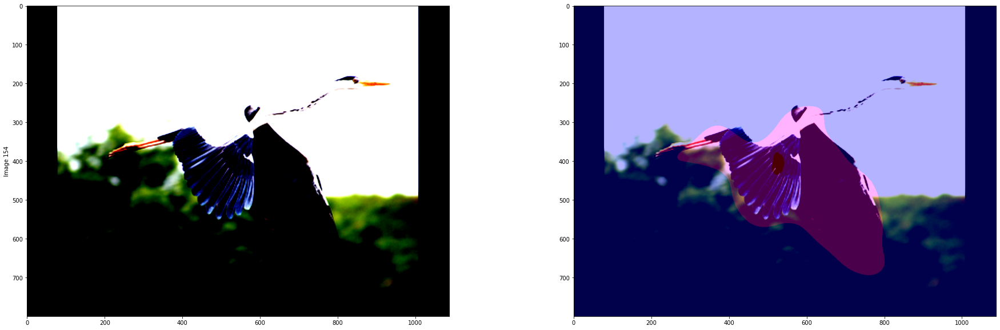

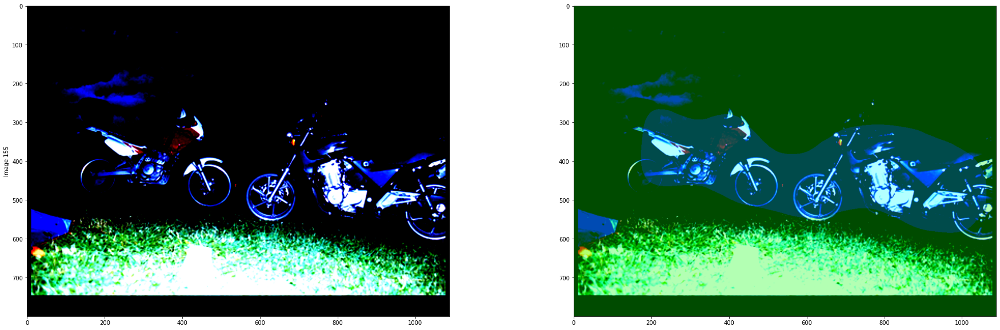

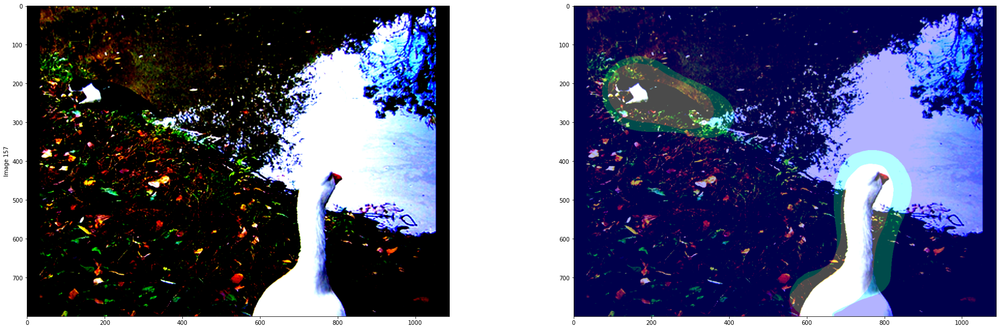

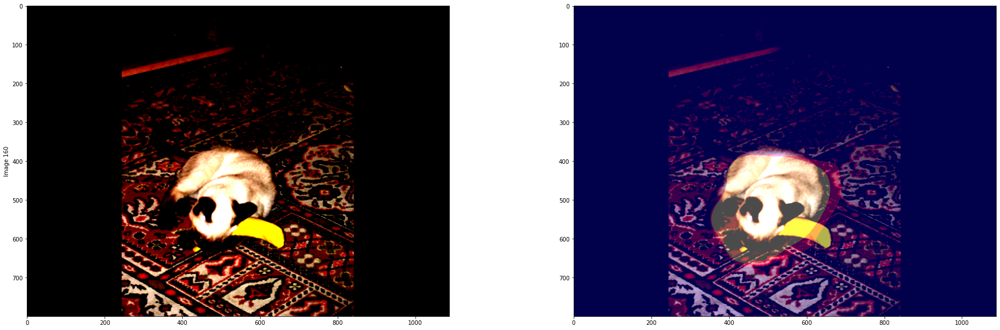

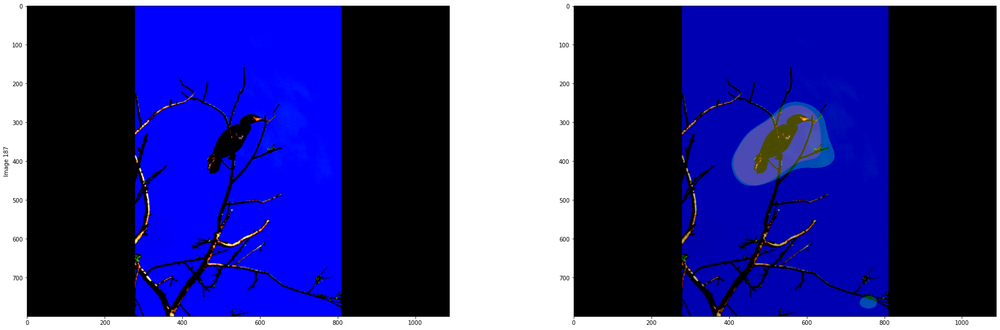

In [97]:
New_images = []

for idx, val in enumerate(test_dataset):
  if idx == 10:
    break
  New_images.append(train_dataset[val][0])

for i, label_idx in enumerate(true_indexes):
  fig     = plt.figure(figsize=(100, 10))
  ax      = fig.add_subplot(1, 6, 1)
  image   = np.transpose(New_images[i], (1,2,0))

  ax.imshow(image)
  
  if i == 0:
    ax.set_title("True Image")
  ax.set_ylabel("Image " + str(label_idx))
  
  if i == 0:
    plt.suptitle("Inference visualization: Masks, Class legend: Cat=Blue, Bike=Red, Person=Green")
  
  #Post Process Results
  ax = fig.add_subplot(1, 6, 2)
  mask_to_display = model.post_process(New_images[i], i)

  ax.imshow(image)
  ax.imshow(mask_to_display, alpha=0.3)

  if i == 0:
    ax.set_title("Inference output")
    
plt.show()

del New_images, mask_to_display

### Part A Submission
In addition to the code you used, you should submit a pdf containing the following plots:
* Dataset visualization plots such as fig. 5 and 6. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Target assignment plots such as fig. 8 and 9. Should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.

We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so.

---------------Dataset Visualisation------------------------
------------------------------------------------------------


---------------Target Assignment Plots------------------------
--------------------------------------------------------------


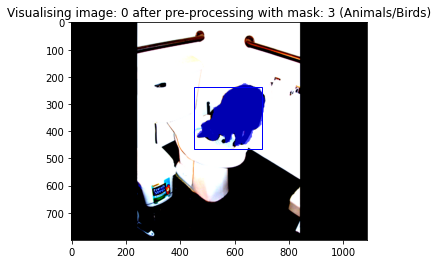

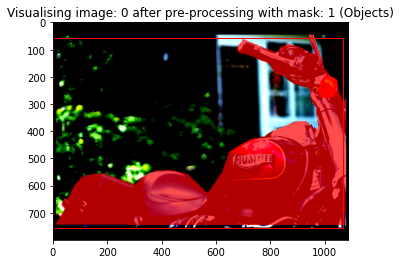

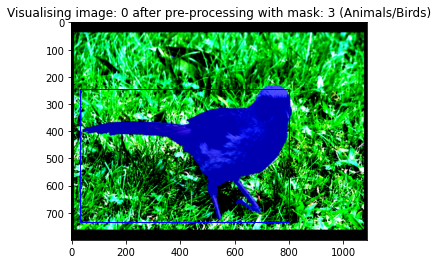

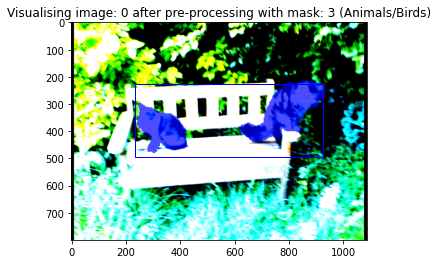

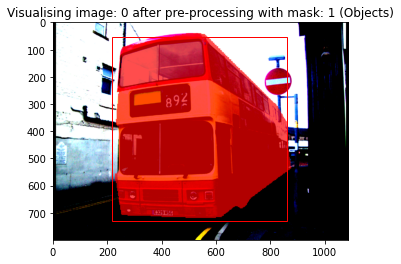

...

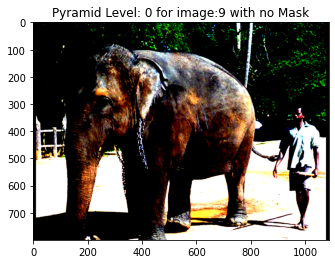

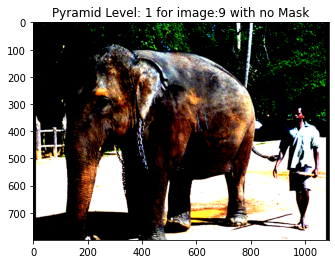

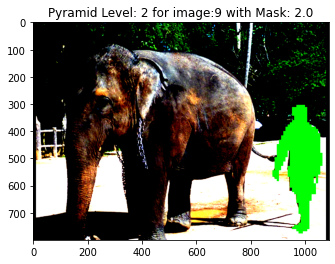

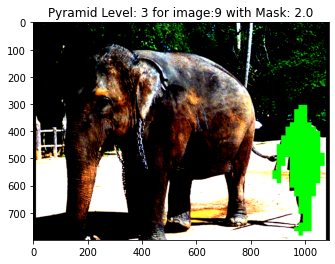

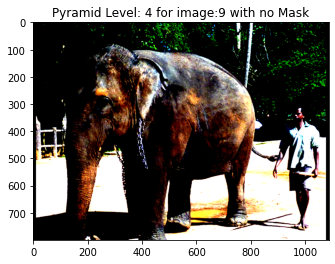

In [118]:
import warnings
warnings.filterwarnings('ignore')

def function_to_run(image_path, label_path, bbox_path, mask_path):

    # path = [image_path, label_path, bbox_path, mask_path]
    # dataset = MyDataset(
    #         path,
    #         transform_images = transforms.Compose([transforms.ToTensor(), transforms.Resize((800,1066)), transforms.Normalize((0.485,0.456,0.406), (0.229,0.224,0.225)),  transforms.Pad((11,0))]),
    #         transform_masks  = transforms.Compose([transforms.ToTensor(), transforms.Resize((800,1066)), transforms.Pad((11,0))])
    #         )

    model = SOLO()
    # print(len(dataset))


    true_img, labels, mask, bboxes = [], [], [], []

    random_visualize = [0,2,15,40,75,100,150,300,1000,2000]
    # random_visualize = []

    print('---------------Dataset Visualisation------------------------')
    print('------------------------------------------------------------')
    for i in random_visualize:
        visualize(dataset[i])

    print('---------------Target Assignment Plots------------------------')
    print('--------------------------------------------------------------')

    for i in random_visualize:
        true_img_1, labels_1, mask_1, bboxes_1 = train_dataset[i]
        true_img.append(true_img_1)
        labels  .append(labels_1)
        mask    .append(mask_1)
        bboxes  .append(bboxes_1)

    mask_tar, category_tar, active_tar = model.generate_targets(bboxes, labels, mask)

    # return category_tar, active_tar
    
    visualise_targets(true_img, labels, mask_tar, category_tar, active_tar)

##################################################################################################################
############################CALL THE FUNCTION BELOW AND CHANGE PATH AS REQUIRED###################################
##################################################################################################################

# image_path  = 'hw3_mycocodata_img_comp_zlib.h5'
# label_path  = 'hw3_mycocodata_labels_comp_zlib.npy'
# bbox_path   = 'hw3_mycocodata_bboxes_comp_zlib.npy'
# mask_path   = 'hw3_mycocodata_mask_comp_zlib.h5'
image_path  = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_img_comp_zlib.h5'
label_path  = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_labels_comp_zlib.npy'
bbox_path   = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_bboxes_comp_zlib.npy'
mask_path   = '/content/drive/MyDrive/UPENN/SEM 3/CIS680/HW3/hw3_mycocodata_mask_comp_zlib.h5'

function_to_run(image_path, label_path, bbox_path, mask_path)

## Part B
### Loss
The loss function consists of two parts: category loss and mask loss:
$$L = \lambda_\text{cate} L_\text{cate} + \lambda_\text{mask} L_\text{mask} $$

The category loss is defined as (where $\text{FL}$ is the focal loss)

$$L_\text{cate} = \frac{1}{S^2 C} \sum_{S,S,C} \text{FL}(p_t)$$

$$\text{FL}(p_t) = -\alpha_t (1 - p_t)^\gamma \log{(p_t)}$$

$$(\alpha_t, p_t) = \left\{\begin{array}{lr} (\alpha, \hat{p}) & \text{if }y=1 \\ (1 - \alpha, 1 - \hat{p}) & \text{otherwise}\end{array}\right.$$

while the mask loss is defined as (where $d_\text{mask}$ is the dice loss)

$$L_\text{mask} = \frac{1}{N_\text{positive}} \sum_k \mathbb{1}_{\{p_{i, j} > 0\}} d_\text{mask}(m_k, \hat{m}_k)$$

$$d_\text{mask}(p, q) = 1 - D(p, q)$$

$$D(p, q) = \frac{2 \sum_{x,y}(p_{x,y} \cdot q_{x,y})}{\sum_{x,y}p_{x,y}^2 + \sum_{x,y}q_{x,y}^2}$$

### Post Processing
Post processing consists of three steps: points NMS, concatenation and sorting, and matrix NMS. A summary of each of these steps is provided below. In addition, your final mask prediction should be a binary mask based on the mask thresholding parameter. Some examples of results post-inference are shown in figs. 11-14.


<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig11.png" width=300/></div>
<center>Figure 11: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig12.png" width=300/></div>
<center>Figure 12: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig13.png" width=300/></div>
<center>Figure 13: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig14.png" width=300/></div>
<center>Figure 14: SOLO instance segmentation example.</center>

#### Points NMS
Non-max suppression for the category predictions, applied to each channel sperately. A maxpooling with a kernel size of 2, sample code is included below.

#### Concatenation and Sorting
Here, we merge the predictions across all the FPN levels into a single list of predictions, sorted by their predicted score. This involves rescaling the predicted masks appropriately.

#### Matrix NMS
Inspired by Soft-NMS, MatrixNMS suppresses mask predictions with a lower score based on their similarity to predictions with a higher score in a completely vectorized manner. Sample code is include below.

### Training
#### Optimizer
The SGD optimizer with a weight decay of 1e-4 and a momentum of 0.9 is used. For a batch size of 16, an initial learning rate of 16 is used (this should be scaled appropriately for different batch sizes). You should train for 36 epochs, reducing the learning rate by a factor of 10 at epochs 27 and 33.

#### Data Augemnetation
To achieve better performance, you may wish to explore some data augmentation techniques. You should be able to achieve the necessary performance without any augmentation, however.

#### Checkpointing
Due to the long training time, we highly recommend that you set up regular checkpointing during your training in case your training gets interrupted (e.g. your colab session ending).

### Part B Submission
In addition to the code you used, you should submit a pdf containing the following plots:
* Dataset visualization plots such as fig. 5 and 6. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Target assignment plots such as fig. 8 and 9. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Final inference results such as figs. 11-14. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Training and validation loss curves. These should include the focal loss, dice loss, and total loss as seperate quantities.

We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so. You do not, however, need to submit your trained weights.

In addition, you should include a discussion of any issues you encountered during this project and any changes you made to the siggested architecture. If you made any interesting observations or thoughts about potential improvements, you should also include them here.

There will likely be a performance benchmark for this project - more details to be announced.

## Answer


Dataloader
We have written a custom class called “MyDataset” which creates our train and test set. The train set and test set are then sent to the dataloader function to create the train and test dataloaders respectively.
Solo Class
We have implemented the CNN and the generate target functions inside the Model CNN Class. We have also included the loss and forward functions and finally the functions to perform training and validation on the network. We have also performed the post processing and visualization of masks in this code cell.
Issues faced 

We ran our model for 40 epochs on the entire dataset using the Google Colab GPU, but we were not able to complete training. The memory available was not enough to train our entire model, so we had to use Colab Pro with the Premium GPU. Initially, in the first few training runs, the Mask loss in our model was constant, there was no decrease. There was a bug in our dataloader which we fixed and finally we were able to get the mask loss to decrease with epochs. We also had to slightly tweak the threshold values in our code to get better mask outputs for our images. Overall, our model was generating good masks at the correct locations. The performance and accuracy of our model could be improved further with additional compute resources and time. Due to overlapping assignments and Mid Terms, we were not able to train our model well enough to be absolutely robust.


## Loss Curves

In [ ]:
torch.save(model10.state_dict(), 'solo_20.pth')
np.save('train_losses_20.npy', model10.train_losses)
np.save('val_losses_20.npy', model10.val_losses)

In [89]:
train_losses = np.load("train_losses_100.npy")
val_losses = np.load("val_losses_100.npy")

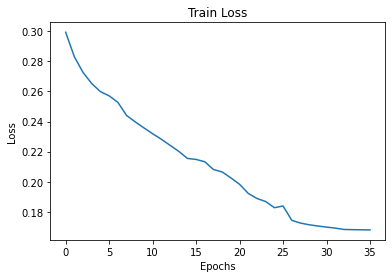

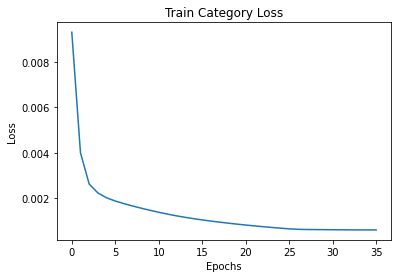

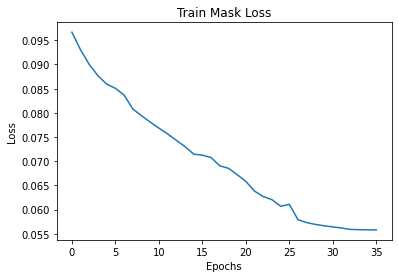

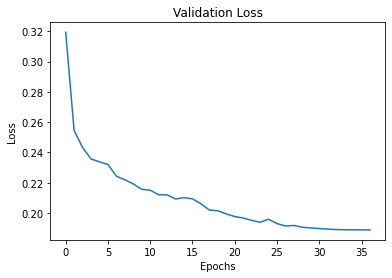

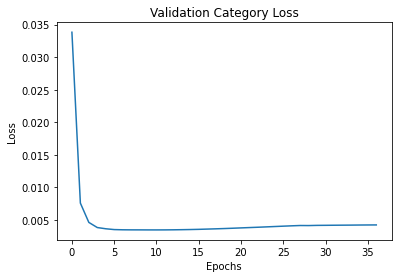

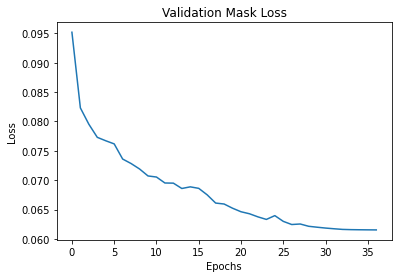

In [98]:
plt.plot(train_losses[:,0])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train Loss')
plt.show()

plt.plot(train_losses[:,1])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train Category Loss')
plt.show()

plt.plot(train_losses[:,2])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train Mask Loss')
plt.show()

plt.plot(val_losses[:,0])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Loss')
plt.show()

plt.plot(val_losses[:,1])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Category Loss')
plt.show()

plt.plot(val_losses[:,2])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Mask Loss')
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs9/lightning_logs/ # TODO1 : what is the x axis here ? in the tensorboard

<IPython.core.display.Javascript object>